In [1]:
import numpy as np
import pandas as pd
import os
from icecream import ic

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
sns.set()

In [3]:
data_dir: str = './Dataset/Custom DataSet/'

In [4]:
import tensorflow as tf

In [5]:
data = tf.keras.utils.image_dataset_from_directory(data_dir)

Found 22171 files belonging to 28 classes.


2024-01-15 10:06:08.210379: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1
2024-01-15 10:06:08.210414: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 8.00 GB
2024-01-15 10:06:08.210429: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 2.67 GB
2024-01-15 10:06:08.210754: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-01-15 10:06:08.211101: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [6]:
data_iterator = data.as_numpy_iterator()

In [7]:
batch = data_iterator.next()

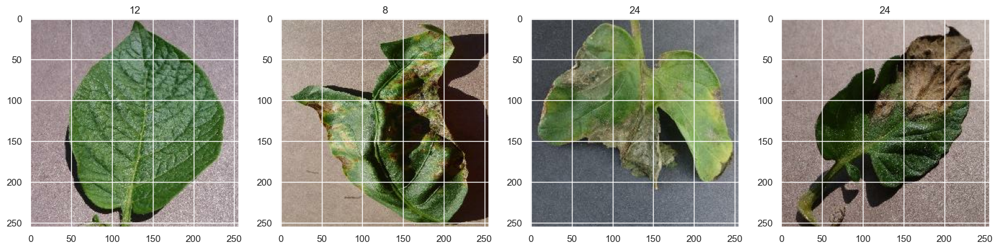

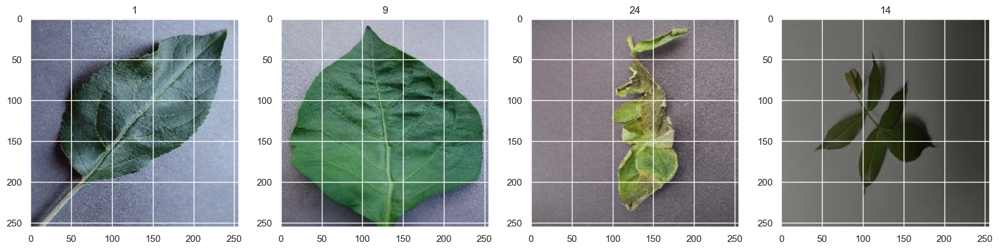

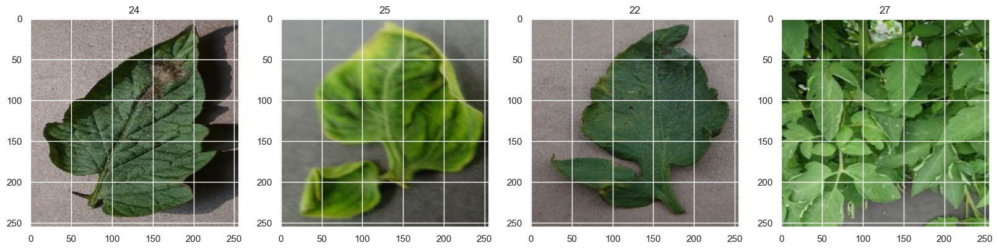

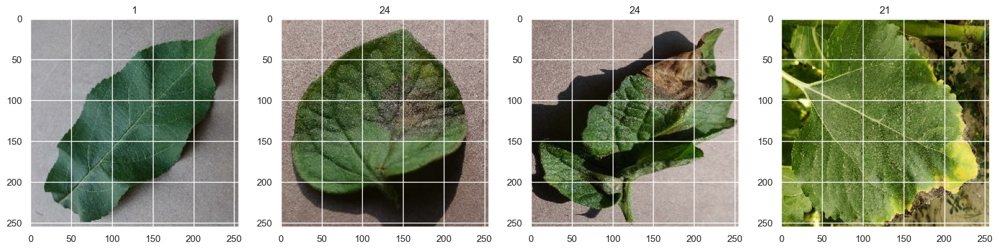

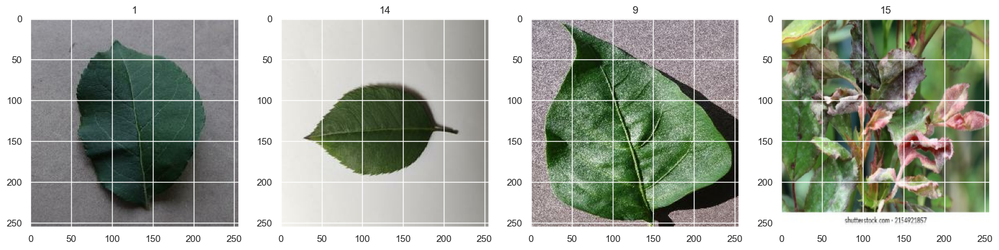

...

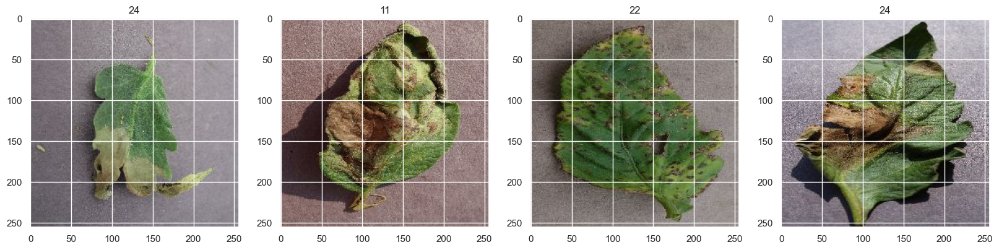

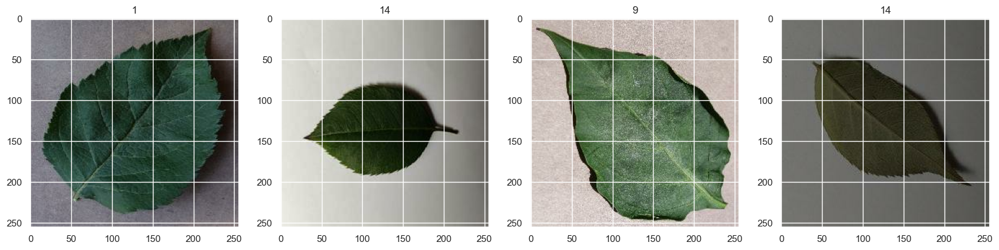

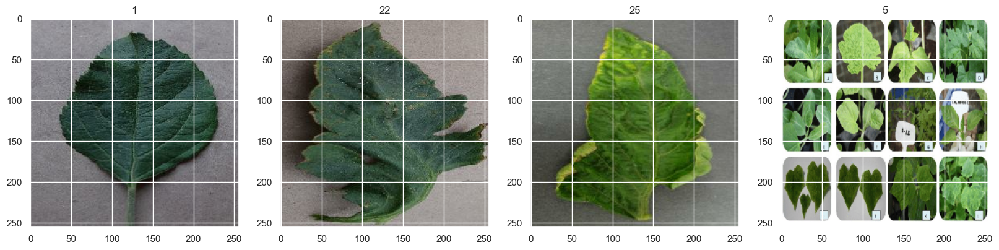

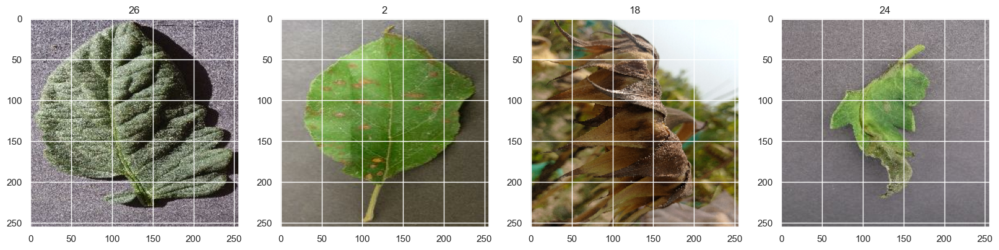

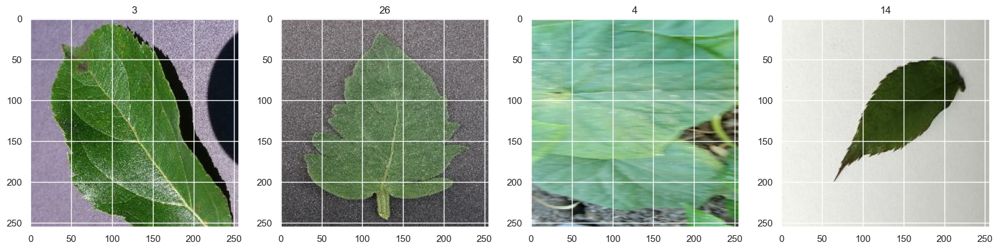

In [12]:
for i in range(13):
    batch = data_iterator.next()
    fig, ax = plt.subplots(ncols=4, figsize=(20,20))

    for idx, img in enumerate(batch[0][:4]):
        ax[idx].imshow(img.astype(int))
        ax[idx].title.set_text(batch[1][idx])

In [5]:
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

In [6]:
model = load_model('Plant_Disease_ResNet50V2_New.h5')

2024-01-15 13:28:35.636852: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1
2024-01-15 13:28:35.636880: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 8.00 GB
2024-01-15 13:28:35.636886: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 2.67 GB
2024-01-15 13:28:35.636938: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-01-15 13:28:35.636960: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [7]:
model

In [9]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [88]:
datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.01  # Reserve 20% of images for validation (testing)
)

In [89]:
test_generator = datagen.flow_from_directory(
    data_dir,
    target_size=(224, 224),
    batch_size=1,  # Use a batch size of 1 to predict on single images
    class_mode='categorical',
    shuffle=False,  # Do not shuffle so filenames match up
    subset='validation'  # Use the validation split as the test set
)

Found 211 images belonging to 28 classes.


In [90]:
class_indices = test_generator.class_indices

In [91]:
idx_to_class = {v: k for k, v in class_indices.items()}

In [92]:
filenames = test_generator.filenames
num_samples = len(filenames)

In [93]:
predictions = model.predict(test_generator, steps=num_samples)

211/211 [==============================] - 7s 30ms/step


In [94]:
num, yo = test_generator.next()
np.argmax(yo)

0

In [95]:
predicted_class = np.argmax(predictions, axis=1)

In [96]:
class_label = list(test_generator.class_indices.keys())

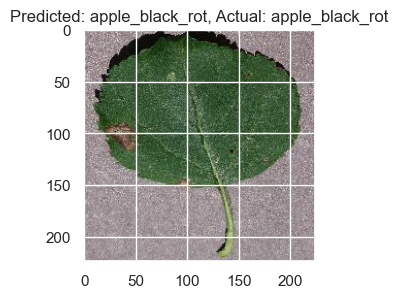

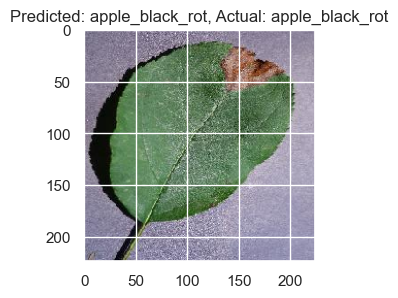

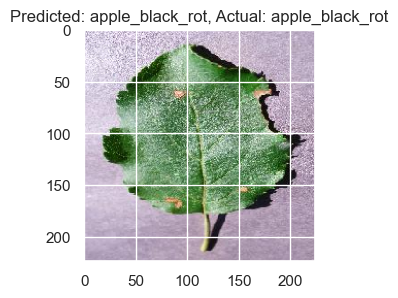

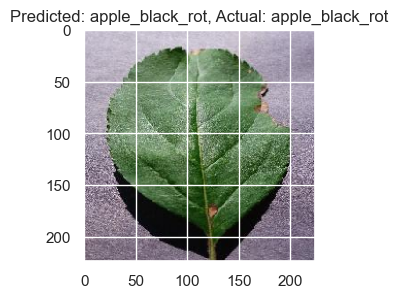

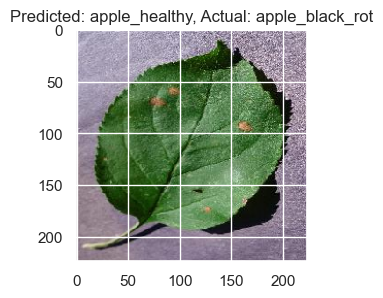

...

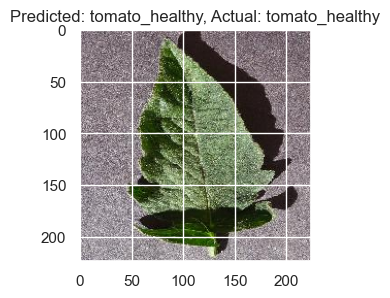

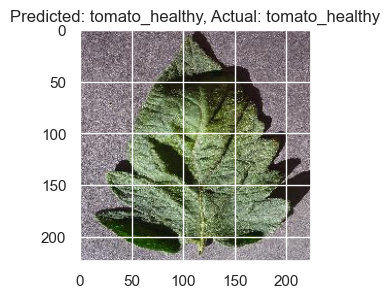

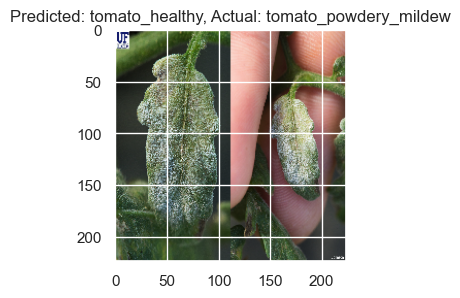

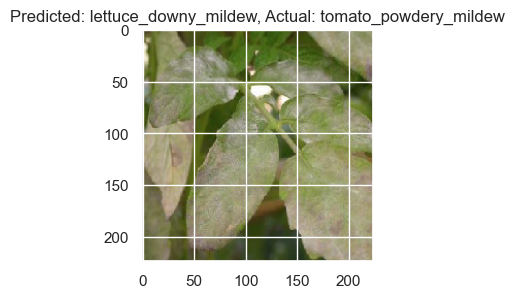

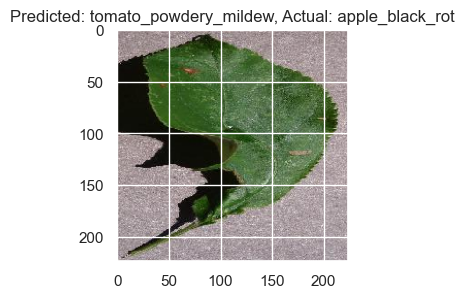

In [97]:
for i in range(num_samples):
    plt.figure(figsize=(3,3))
    img, label = test_generator.next()
    img = np.squeeze(img)
    predicted_label = class_label[predicted_class[i]]
    acctual_label = class_label[np.argmax(label)]
    plt.imshow(img)
    plt.title(f"Predicted: {predicted_label}, Actual: {acctual_label}")
    plt.show()